In [23]:
%%HTML
<script>
    var code_show=true; //true -> hide code at first

    function code_toggle() {
        $('div.prompt').hide(); // always hide prompt

        if (code_show){
            $('div.input').hide();
        } else {
            $('div.input').show();
        }
        code_show = !code_show
    }
    $( document ).ready(code_toggle);
</script>

<a href="javascript:code_toggle()">[Toggle Code]</a>

# Part 1: Intro to linear regression and gradient descent

In [20]:
# imports from custom library
import sys
sys.path.append('../../')
import matplotlib.pyplot as plt
from mlrefined_libraries import superlearn_library as superlearn
from mlrefined_libraries import calculus_library as callib
from mlrefined_libraries import math_optimization_library as optlib
import autograd.numpy as np
import math
import pandas as pd
%matplotlib notebook

# this is needed to compensate for %matplotlib notebook's tendancy to blow up images when plotted inline
from matplotlib import rcParams
rcParams['figure.autolayout'] = True

%load_ext autoreload
%autoreload 2

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


# 1.  Intro to linear regression

With linear regression we aim to fit a line (or hyperplane in higher dimensions) to a scattering of data. In this Section we describe the fundamental concepts underlying this procedure. 

## 1.1  Notation and modeling

Data for regression problems comes in the form of a set of
$P$ input/output observation pairs

\begin{equation}
 \left(\mathbf{x}_{1},y_{1}\right),\,\left(\mathbf{x}_{2},y_{2}\right),\,...,\,\left(\mathbf{x}_{P},y_{P}\right)
\end{equation}

or $\left\{ \left(\mathbf{x}_{p},y_{p}\right)\right\} _{p=1}^{P}$ for short, where $\mathbf{x}_{p}$ and $y_{p}$ denote the $p^{\textrm{th}}$ input and output respectively. 

In general each input $\mathbf{x}_{p}$ may be a column vector of length $N$

\begin{equation}
\mathbf{x}_{p}=\left[\begin{array}{c}
x_{1,p}\\
x_{2,p}\\
\vdots\\
x_{N,p}
\end{array}\right]
\end{equation}

in which case the linear regression problem is analogously one of fitting a hyperplane to a scatter of points in $N+1$ dimensional space. 

<figure>
  <img src= '../../mlrefined_images/superlearn_images/Fig_3_1_new.png' width="95%" height="auto" alt=""/>
</figure>

In the case of scalar input the fitting of a line to the data requires we determine a vertical intercept $w_0$ and slope $w_1$ so that the following approximate linear relationship
holds between the input/output data

\begin{equation}
w_{0}+x_{p}w_{1}\approx y_{p},\quad p=1,...,P.
\end{equation}

More generally, when dealing with $N$ dimensional input we have a bias and $N$ associated slope weights to tune properly in order to fit a hyperplane, with the analogous linear relationship written as

\begin{equation}
w_{0}+ x_{1,p}w_{1} + x_{2,p}w_{2} + \cdots + x_{N,p}w_{N} \approx y_{p} ,\quad p=1,...,P.
\end{equation}

For any $N$ we can write the above more compactly by denoting

\begin{equation}
\mathbf{w}=\left[\begin{array}{c}
w_{1}\\
w_{2}\\
\vdots\\
w_{N}
\end{array}\right]
\end{equation}

as

\begin{equation}
w_0+\mathbf{x}_{p}^T\mathbf{w} \approx y_{p} ,\quad p=1,...,P.
\end{equation}

## 1.2  The Least Squares cost function

- To find the parameters of the hyperplane which best fits a regression dataset we form a *Least Squares cost function*. 



- For a given set of parameters $\mathbf{w}$ this cost function computes the total squared error between the associated hyperplane and the data.

<figure>
  <img src= '../../mlrefined_images/superlearn_images/Least_Squares.png' width="90%" height="auto" alt=""/>
</figure>

We want to find a weight vector $\mathbf{w}$ and the bias $w_0$ so that each of following $P$ approximate equalities holds as well as possible. 

\begin{equation}
w_0+\mathbf{x}_{p}^T\mathbf{w} \approx y_{p}
\end{equation}

Another way of stating the above is to say that the *error* between $w_0+\mathbf{x}_{p}^{T}\mathbf{w}$ and $y_{p}$ is small. 

\begin{equation}
\left(w_0+\mathbf{x}_{p}^{T}\mathbf{w} - y_{p}^{\,}\right)^2
\end{equation}

\begin{equation}
\,g\left(w_0,\mathbf{w}\right)=\sum_{p=1}^{P}\left(w_0+\mathbf{x}_{p}^{T}\mathbf{w}-y_{p}^{\,}\right)^{2}
\end{equation}

- We want parameters $w_0$ and $\mathbf{w}$ that provide a small value for $g\left(w_0,\mathbf{w}\right)$ 

- In other words, we want to determine a value for the pair $w_0$ and $\mathbf{w}$ that *minimizes* $g\left(w_0,\mathbf{w}\right)$, 

\begin{equation}
\underset{w_0,\,\mathbf{w}}{\mbox{minimize}}\,\,\underset{p=1}{\overset{P}{\sum}}\left(w_0+\mathbf{x}_{p}^{T}\mathbf{w}-y_{p}^{\,}\right)^{2}
\end{equation}

Here is what we will see

<IPython.core.display.Javascript object>


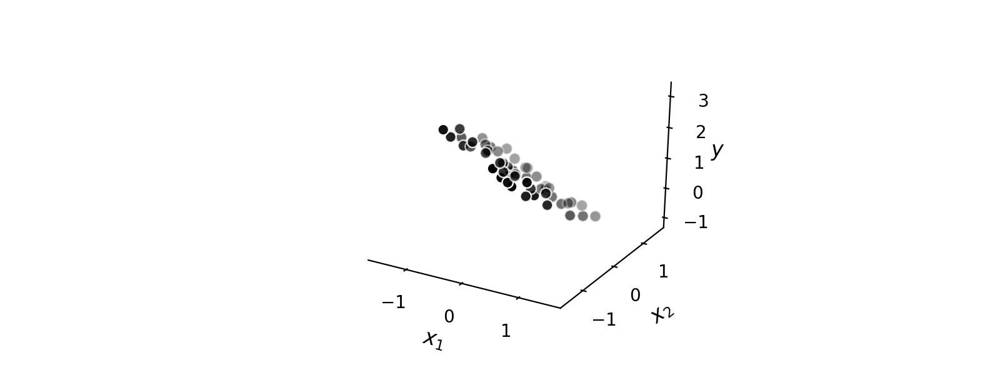

In [12]:
# load in dataset
datapath = '../../mlrefined_datasets/superlearn_datasets/3d_linregress_data.csv'
data = np.asarray(pd.read_csv(datapath,header = None))

# create instance of linear regression demo, used below and in the next examples
demo2 = superlearn.lin_regression_demos.Visualizer(data)

# plot dataset
demo2.plot_data()

In [13]:
# an implementation of the least squares cost function for linear regression for N = 2 input dimension datasets
x = data[:,:-1]    # define input of dataset prior to function definition
y = data[:,-1]    # define output of dataset prior to function definition
def least_squares(w):
    cost = 0
    for p in range(0,len(y)):
        x_p = x[p]
        y_p = y[p]
        a_p = w[0] + sum([a*b for a,b in zip(w[1:],x_p)])
        cost +=(a_p - y_p)**2
    return cost

In [16]:
# declare an instance of our current our optimizers
opt = superlearn.optimimzers.MyOptimizers()

# run desired algo with initial point, max number of iterations, etc.,
w_hist = opt.gradient_descent(g = least_squares,w = np.asarray([1.0,1.0,1.0]),max_its = 100,alpha = 10**-3)


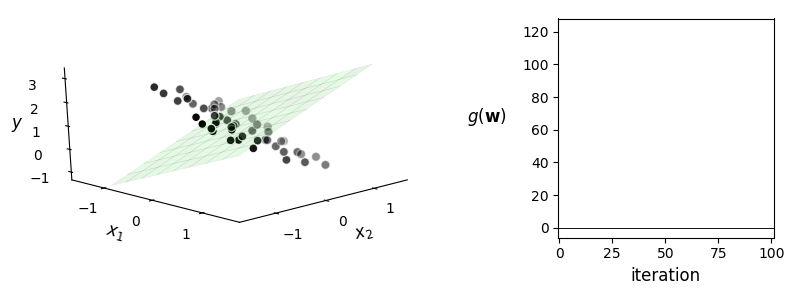
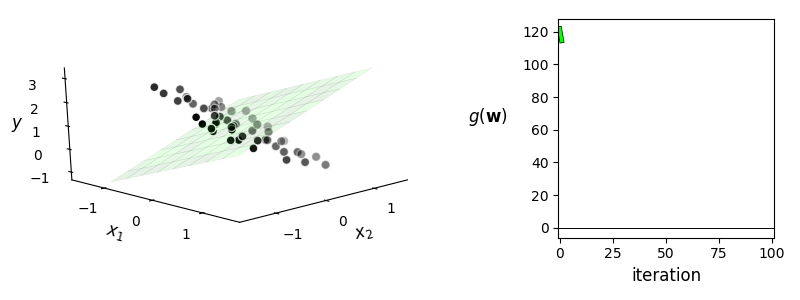
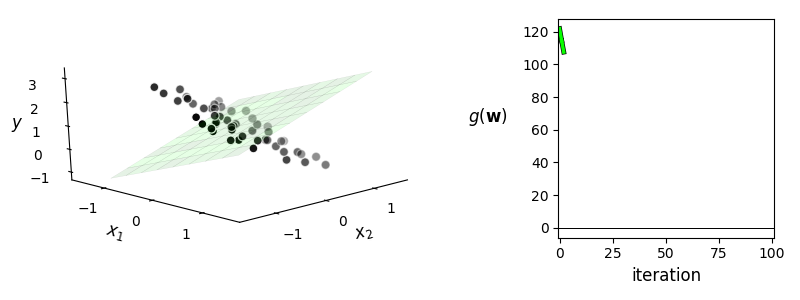
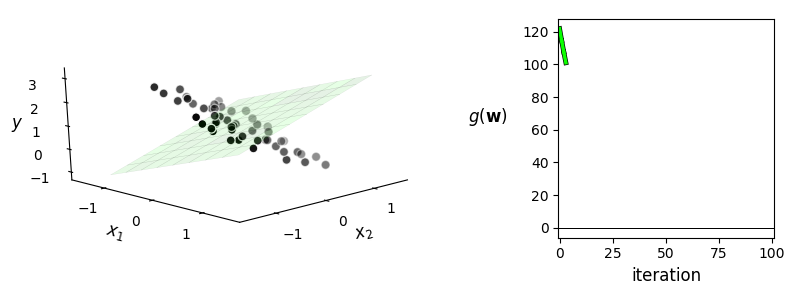
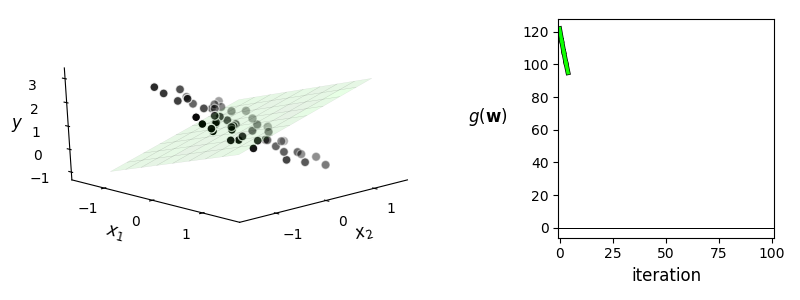
...
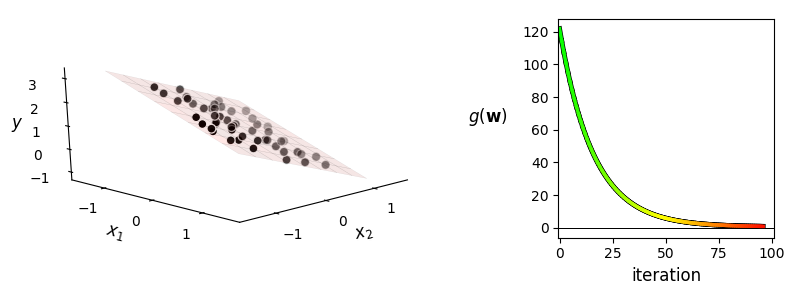
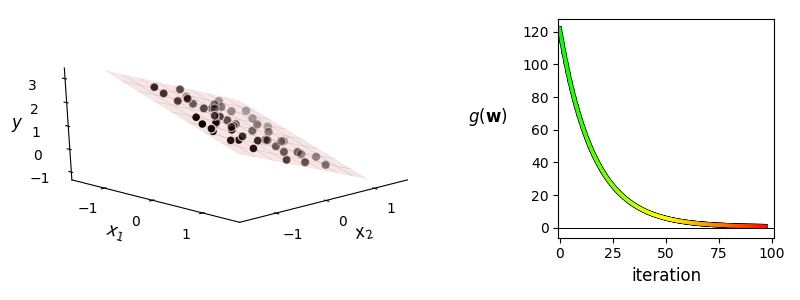
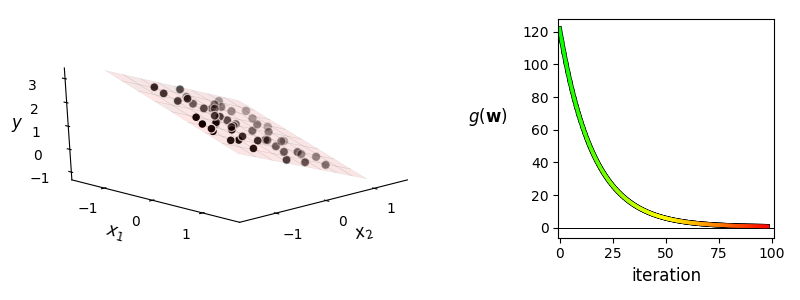
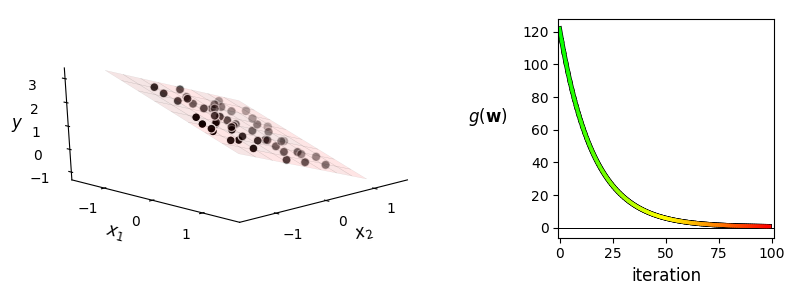
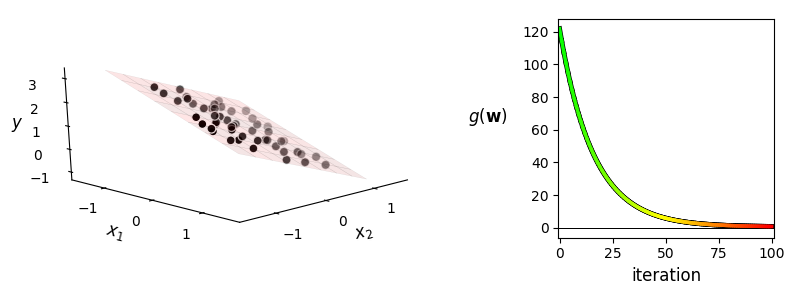

In [18]:
# animate descent process
demo2.animate_it_3d(w_hist,view = [10,-40],viewmax = 1.3)

- how can we do this?

# 2.   Intro to gradient descent

## 2.1  The gradient descent direction


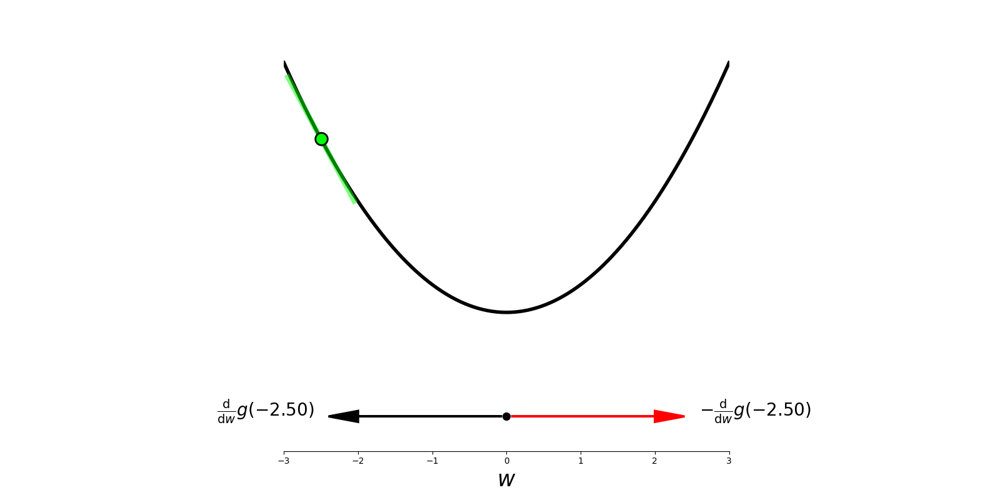
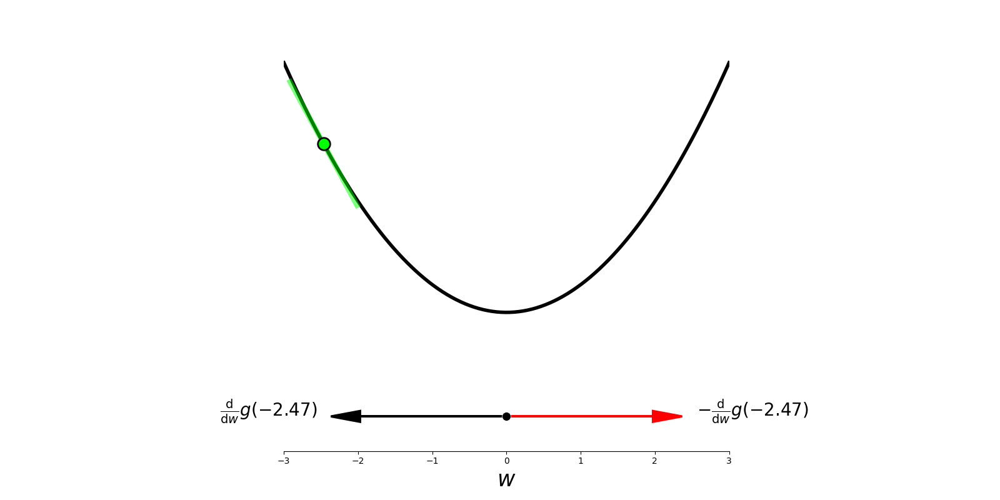
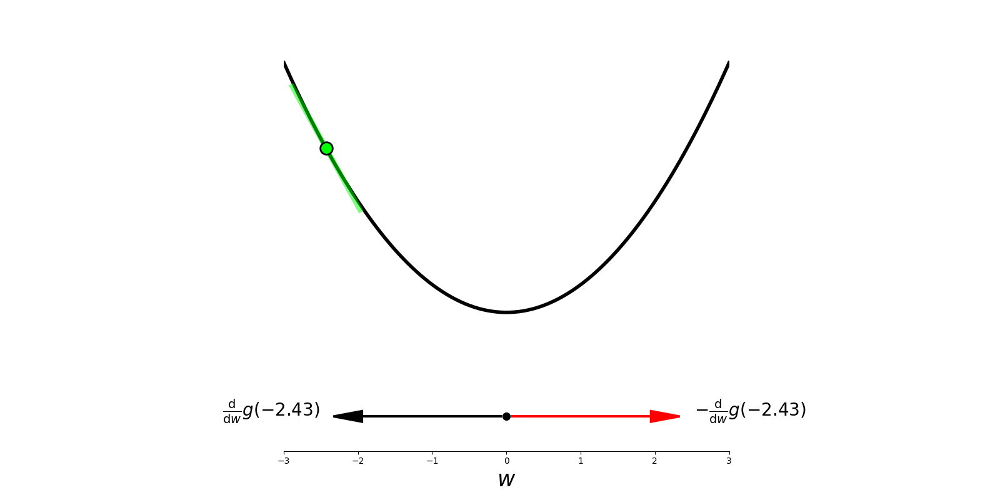
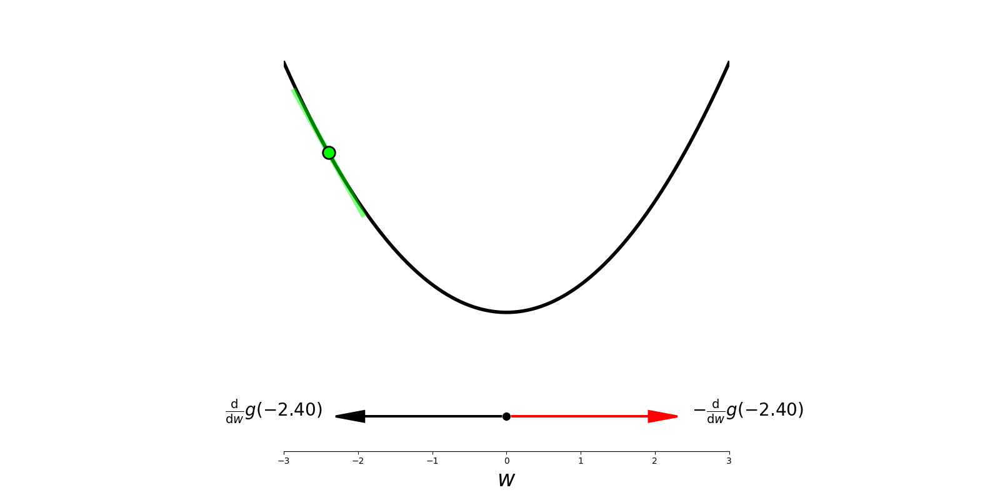
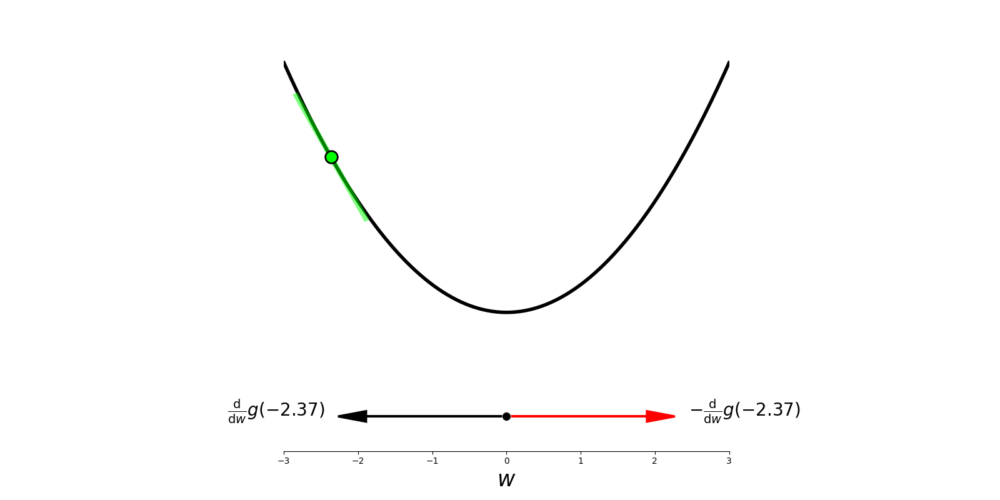
...
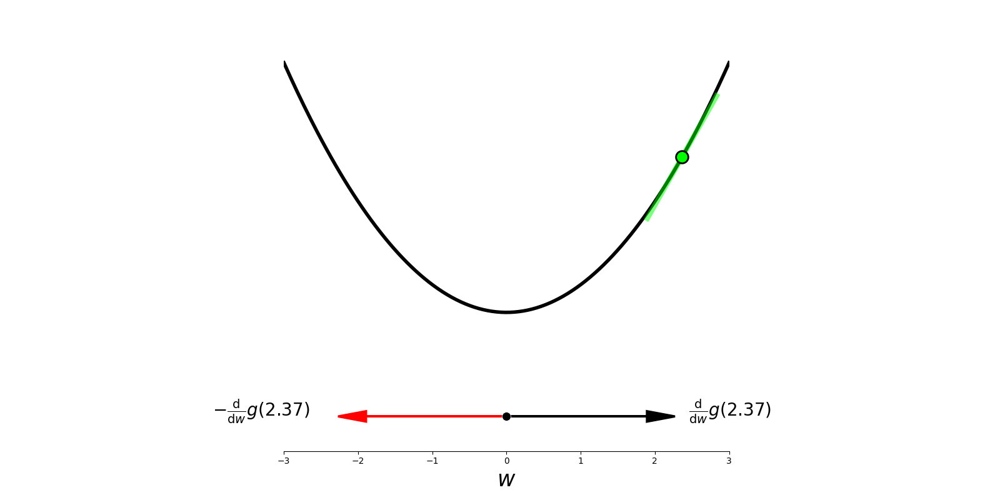
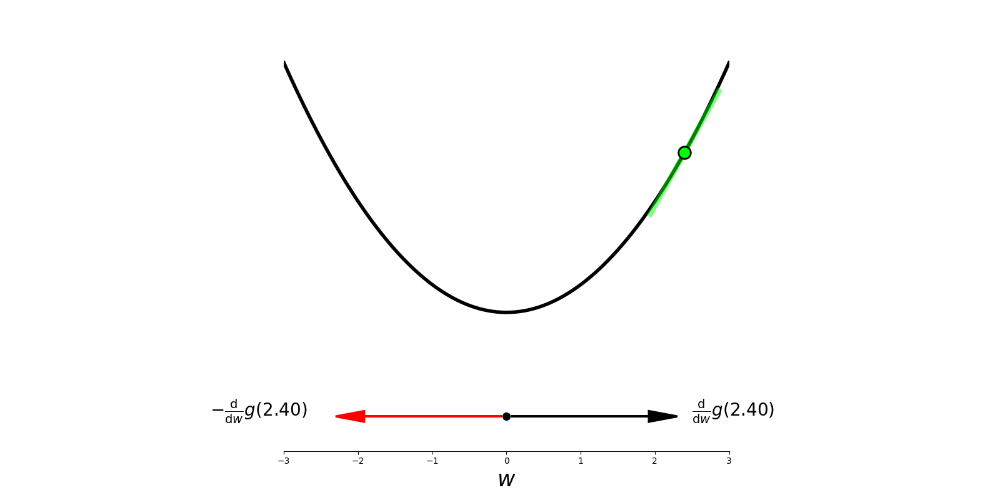
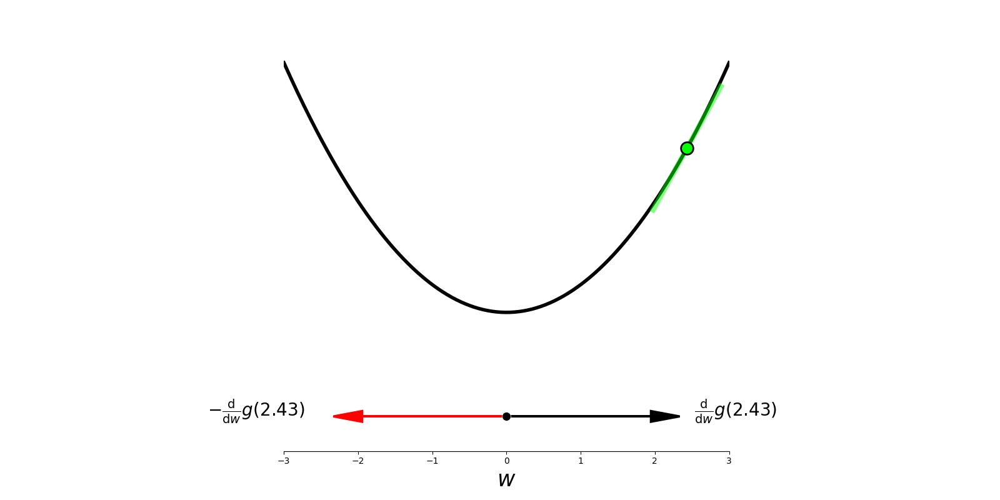
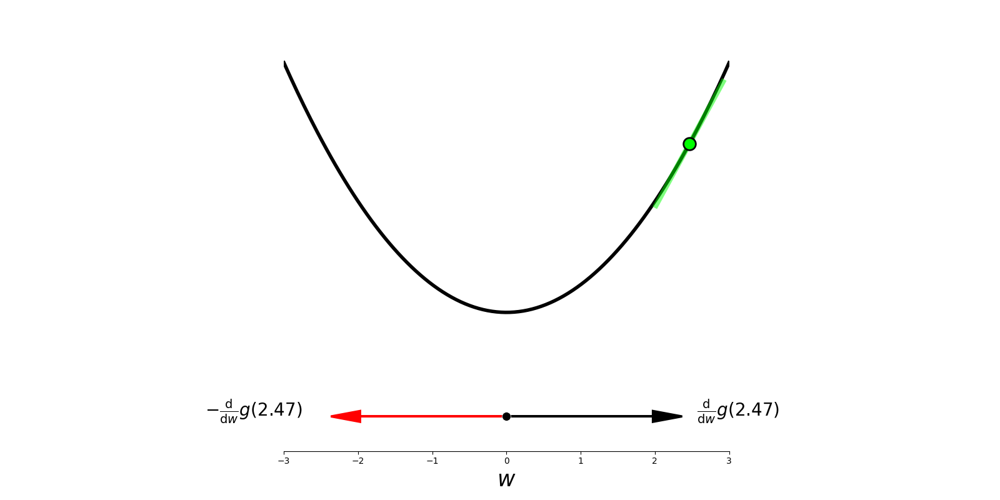
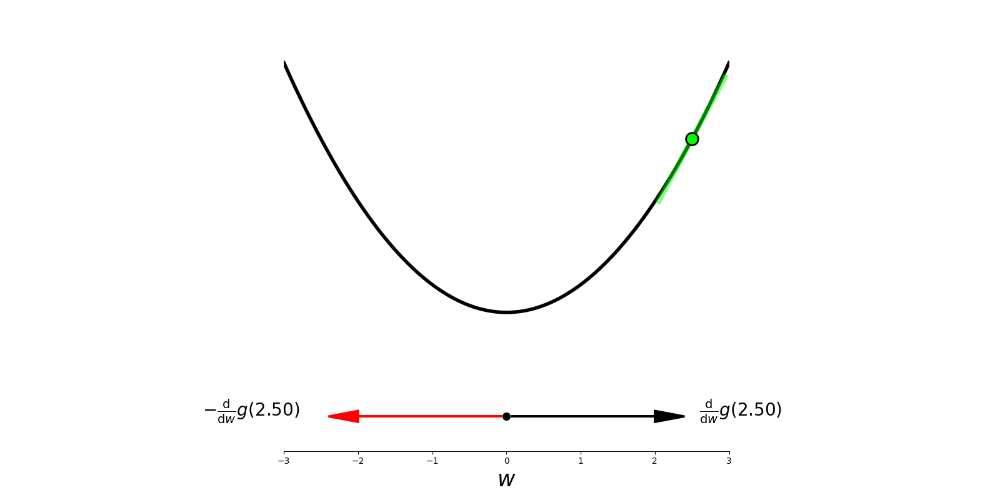

In [7]:
# what function should we play with?  Defined in the next line.
g = lambda w: 0.4*w**2 + 1.5

# run the visualizer for our chosen input function
callib.derivative_ascent_visualizer.animate_visualize2d(g=g,num_frames = 150,plot_descent = True)

- The gradient: a partial derivative in each input coordinate direction

- e.g., if $N = 2$

\begin{equation}
\nabla g(w_1,w_2) = 
\begin{bmatrix}
\
\frac{\partial}{\partial w_1}g(w_1,w_2) \\
\frac{\partial}{\partial w_2}g(w_1,w_2)
\end{bmatrix}
\end{equation}

<IPython.core.display.Javascript object>


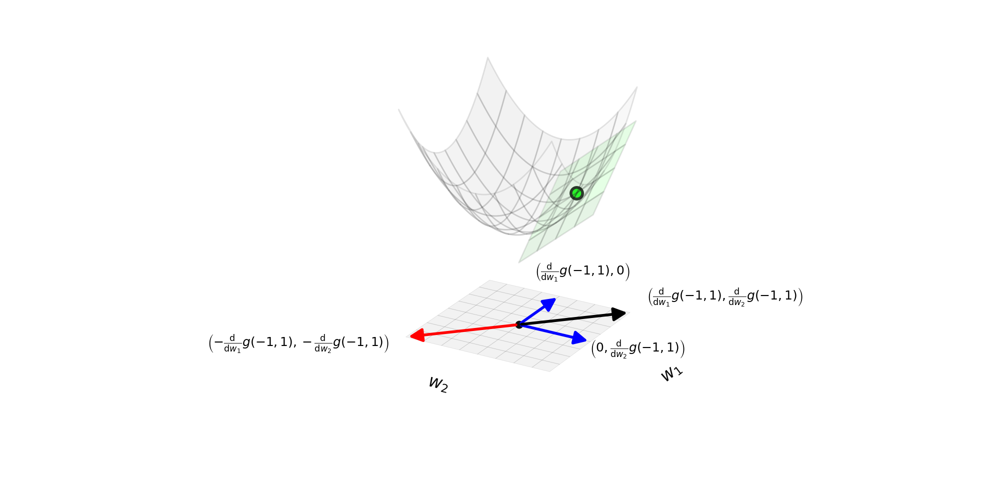

In [8]:
# define function, and points at which to take derivative
func = lambda w:  (w[0])**2 + (w[1])**2 + 6
pt1 = [-1,1];

# animate 2d slope visualizer
view = [33,30]
callib.derivative_ascent_visualizer.visualize3d(func=func,view = view,pt1 = pt1,plot_descent = True)

- The **negative gradient** provides descent direction - always - unless at a *stationary point*

## 2.2  Intuition for gradient descent

- Its like trying to find your way downhill in the complete dark

- To the keynote cartoon!

## 2.3  Basic gradient descent algorithm

<img src="../../mlrefined_images/math_optimization_images/Fig_2_7.png" width=500 height=150/>

These update steps are written mathematically  - when $N = 1$ - as

\begin{equation}
w^{\,k} = w^{\,k-1} - \alpha \frac{\mathrm{d}}{\mathrm{d}w}g\left(w^{\,k-1}\right)
\end{equation}


And when $N \geq1$ more generally as

\begin{equation}
\mathbf{w}^{\,k} = \mathbf{w}^{\,k-1} - \alpha \nabla g(\mathbf{w}^{\,k-1})
\end{equation}


- Here $\alpha$ is called the *steplength parameter* or *learning rate*

### The length of each descent step

- We will see how to choose the steplength parameter $\alpha$ soon

- Note: here the length of each step is precisely $\alpha\left\Vert \nabla g\left(\mathbf{w}^{\,k-1}\right) \right\Vert_2$, not just the steplength parameter itself.

## A demo

Minimize the function

\begin{equation}
g(w) = \frac{1}{50}\left(w^4 + w^2 + 10w\right)
\end{equation}


- has very difficult to compute (by hand) global minimum

\begin{equation}
w = \frac{\sqrt[\leftroot{-2}\uproot{2}3]{\sqrt[\leftroot{-2}\uproot{2}3]{2031} - 45}}{6^{\frac{2}{3}}} - \frac{1}{\sqrt[\leftroot{-2}\uproot{2}3]6\left(\sqrt{2031}-45\right)}
\end{equation}


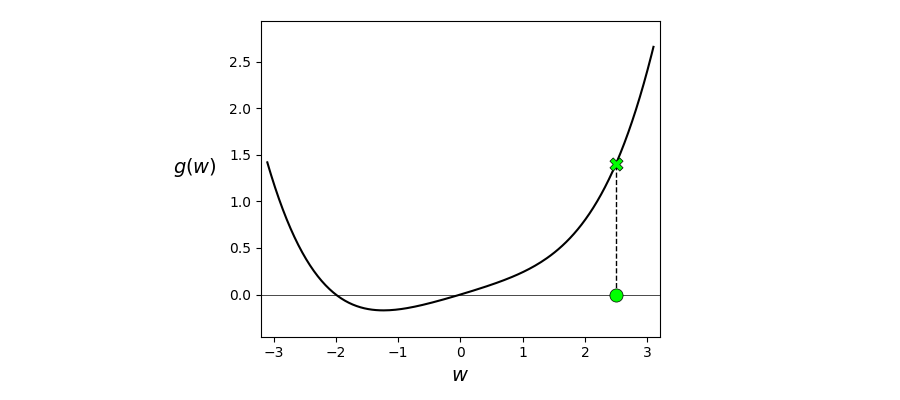
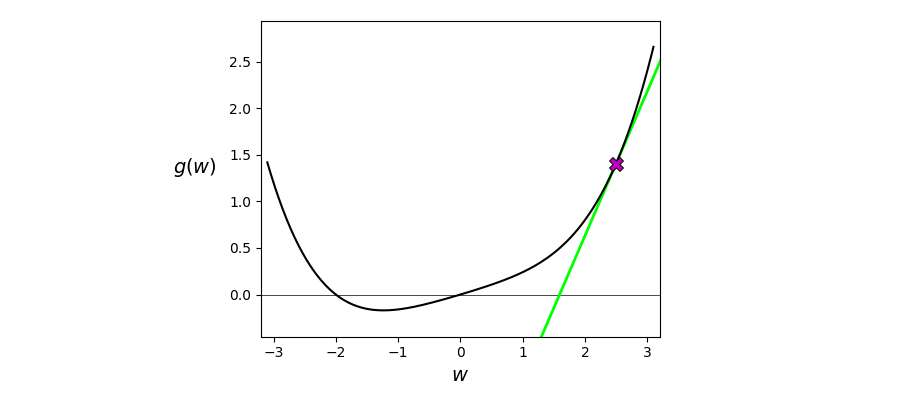
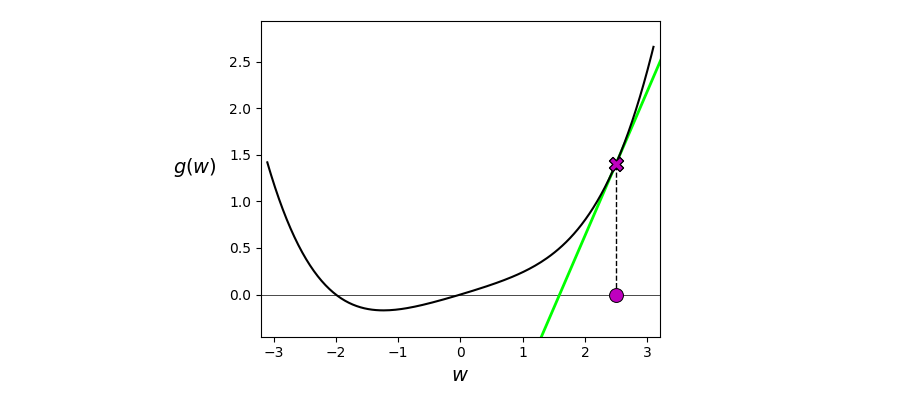
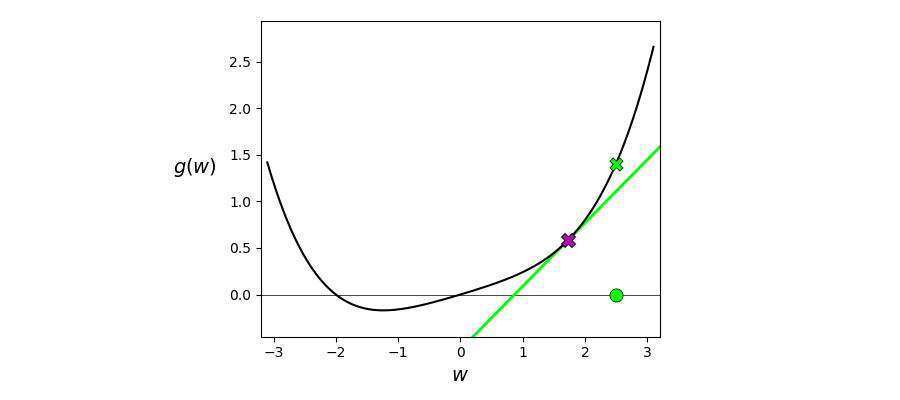
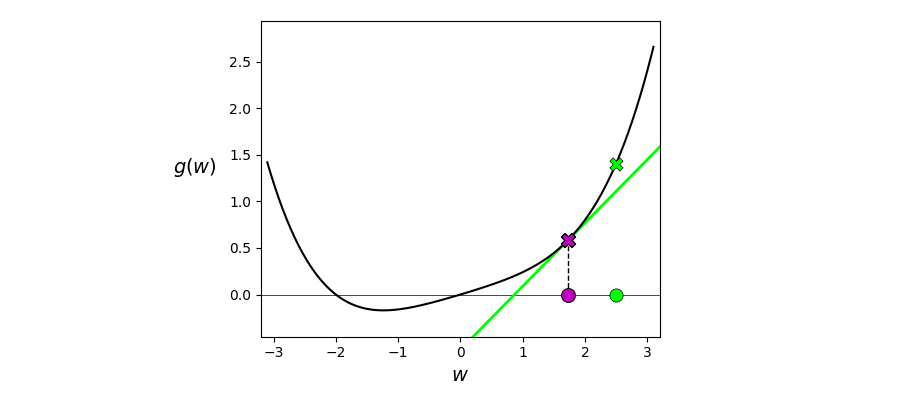
...
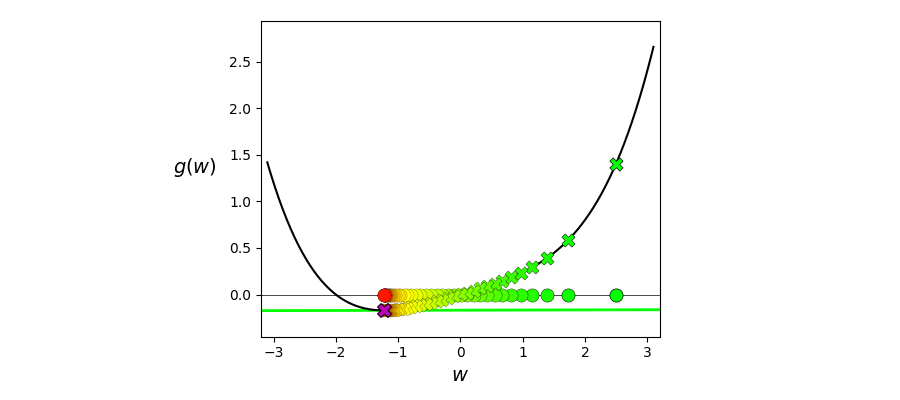
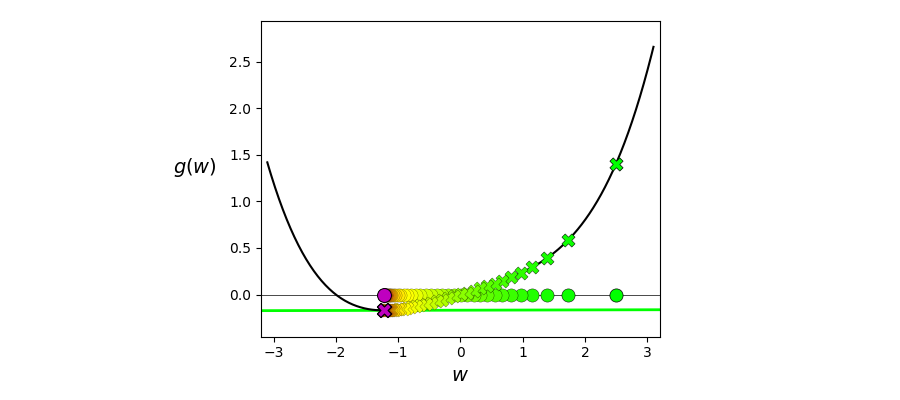
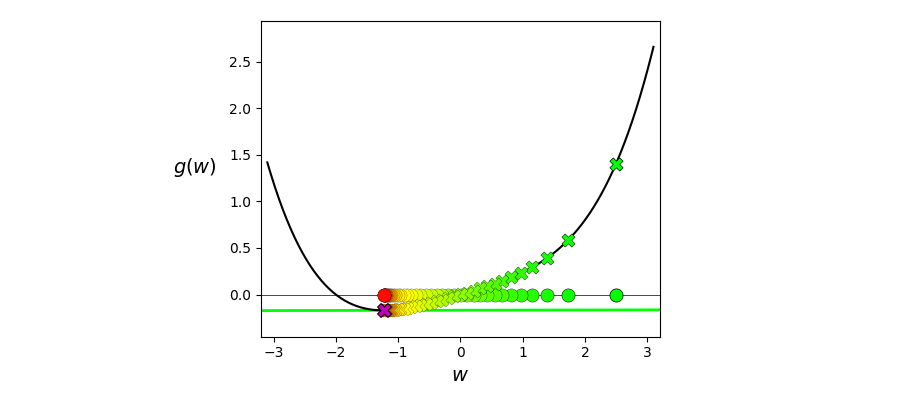
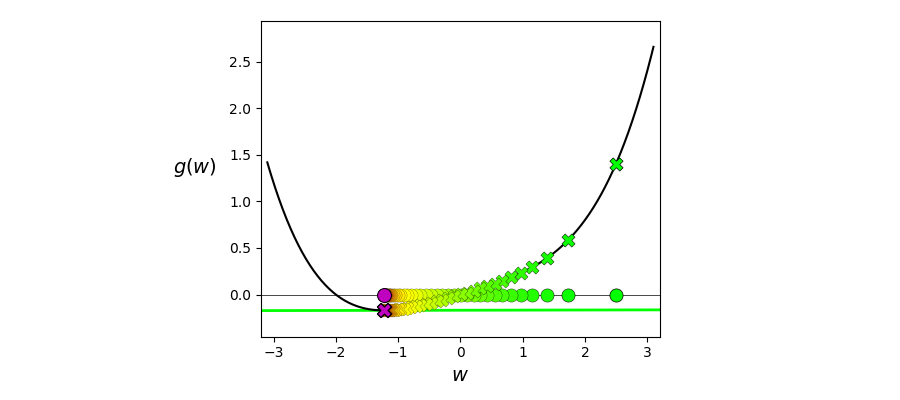
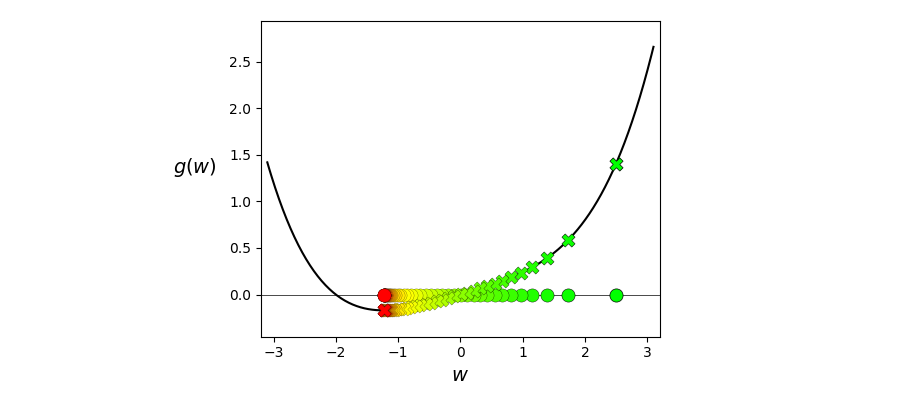

In [21]:
# what function should we play with?  Defined in the next line.
g = lambda w: 1/float(50)*(w**4 + w**2 + 10*w)   # try other functions too!  Like g = lambda w: np.cos(2*w) , g = lambda w: np.sin(5*w) + 0.1*w**2, g = lambda w: np.cos(5*w)*np.sin(w)

# run the visualizer for our chosen input function, initial point, and step length alpha
demo = optlib.gradient_descent_demos.visualizer();

demo.animate_2d(g=g, w_init = 2.5,steplength = 0.5,max_its = 45,version = 'unnormalized')

## Steplength selection in general


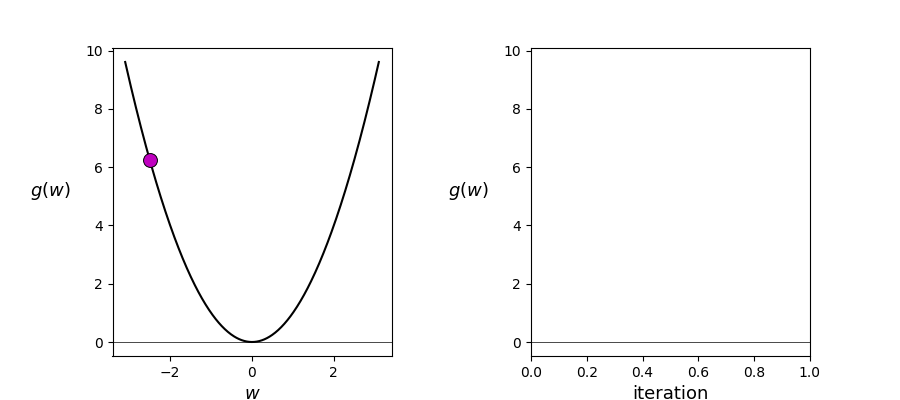
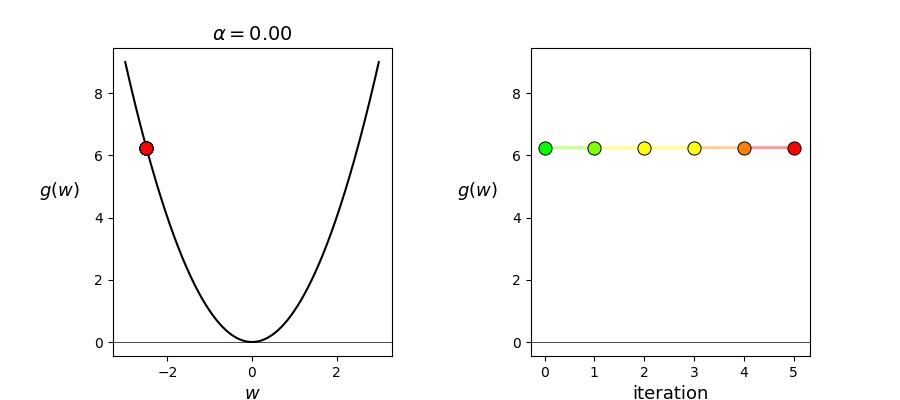
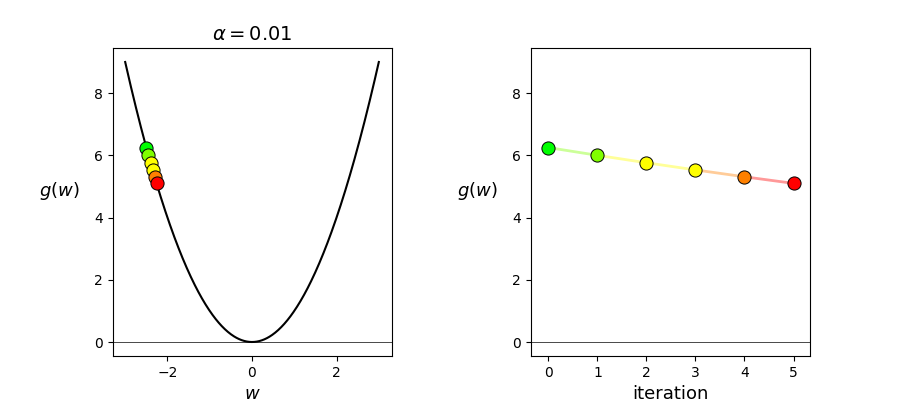
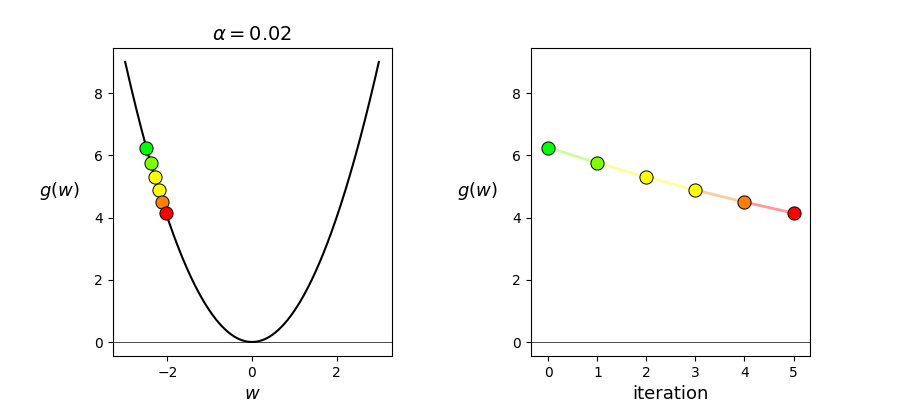
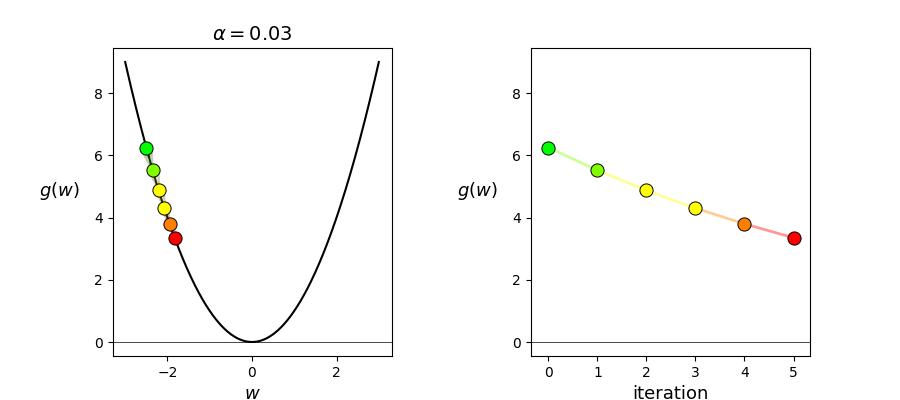
...
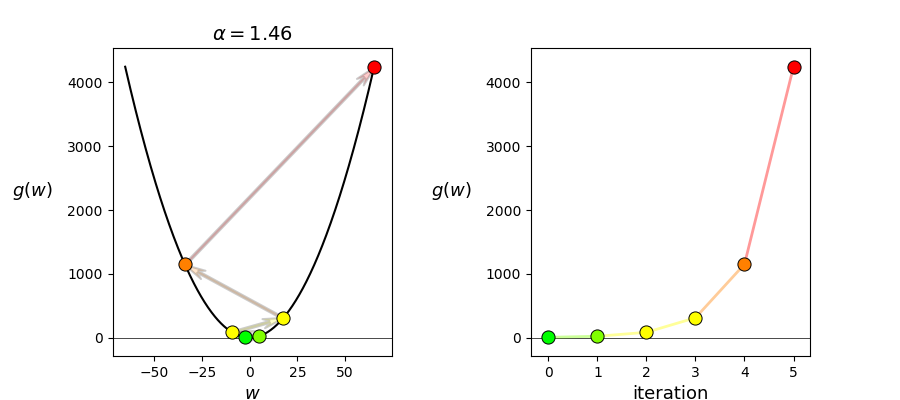
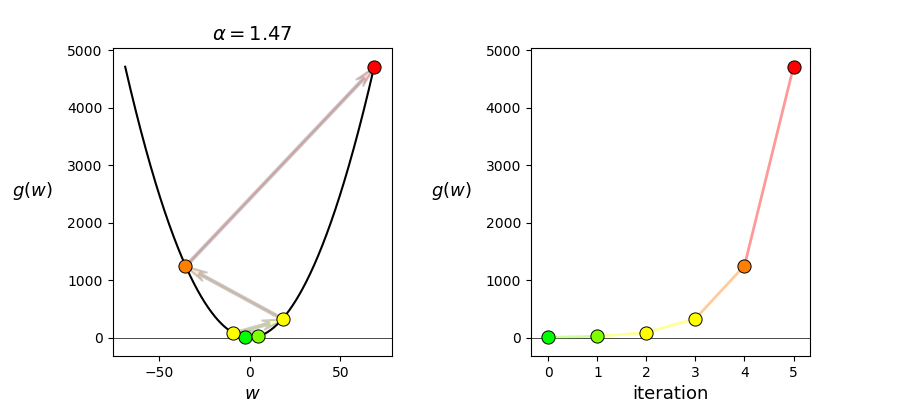
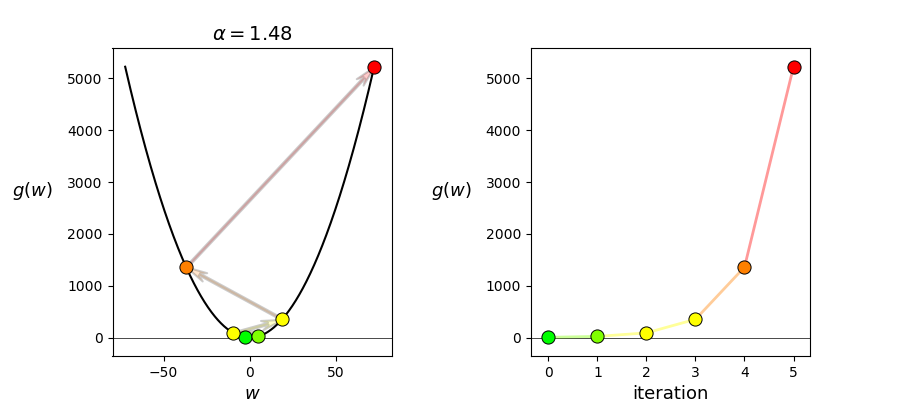
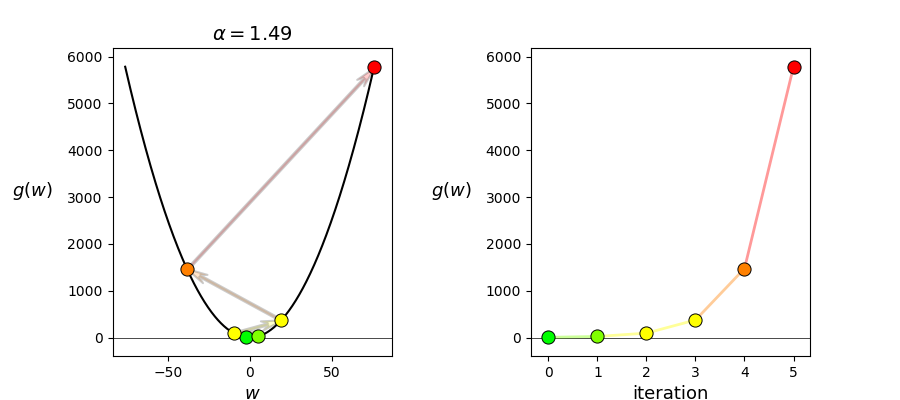
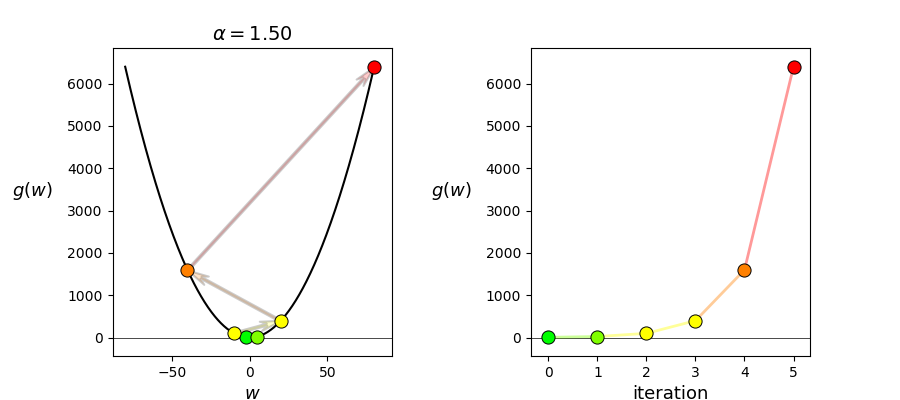

In [22]:
# what function should we play with?  Defined in the next line., nice setting here is g = cos(2*w), w_init = 0.4, alpha_range = np.linspace(2*10**-4,1,200)
g = lambda w: w**2

# create an instance of the visualizer with this function
demo = optlib.grad_descent_steplength_adjuster_2d.visualizer()

# run the visualizer for our chosen input function, initial point, and step length alpha
w_init = -2.5
steplength_range = np.linspace(10**-5,1.5,150)
max_its = 5
demo.animate_it(w_init = w_init, g = g, steplength_range = steplength_range,max_its = max_its,tracers = 'on',version = 'unnormalized')